In [ ]:
from JupyterImport import *
from src.DataStandardize.ExpSpecific.Sep20 import Fixes
root_logger.setLevel(logging.WARNING)

In [ ]:
# dats = get_dats((1613,1622+1), overwrite=False)  # current amp at 1e9
# dats.extend(get_dats((1623,1632+1), overwrite=False))  # current amp at 1e8
# dats.extend(get_dats((1633, 1642+1), overwrite=False))  # CA1e9, slower sweeping (40 vs 200mV/s)
# dats.extend(get_dats((1699, 1700+1)))  # Just the -420mV scans from below

# dats = get_dats((1689, 1708+1))  # 2 part entropy repeats along transition. -220mV LCSS
# dats.extend(get_dats((1709, 1728+1)))  # Same with -224mV LCSS 

# dats.extend(get_dats((1729, 1736+1)))  # Start of above scans vs temp, but it crashed
# dats.extend(get_dats((1738, 1771+1)))  # Fast set of above (not as many points to make it quicker, and less averaging) at 175, 100, 50, 250mK


# dats = get_dats((1772, 1879+1))  # -around -200mT in 1mT steps (24mT span total) many places along transition.

# dats = get_dats((1880, 2133+1))  # -200mT small steps in transition at many places on LCT


# dats = get_dats((2134, 2173+1))  # Entropy vs temp at -100mT

# dats = get_dats((2174, 2203+1))  # BAD: interrupted too much... Small steps in field at 250mK. around -100mT (Computer crashed so incomplete)
# dats.extend(get_dats((2206, 2223+1)))  # BAD interrupted too much.

# dats = get_dats((2225, 2308+1))  # Around -100mT in 0.5mT steps at 250mK
# dats = get_dats((2309, 2394+1))  # Around -50mT in 0.5mT steps at 250mK

# dats = get_dats((2401, 2438+1))  # Entropy vs temp at -50mT
# dats = get_dats((2439, 2522+1))  # Around -20mT in 0.5mT steps at 250mK

# dats = get_dats((2523, 2712+1))  #  Entropy vs small steps in field around -50mT at low T 50mK

# dats = get_dats((2713, 2750+1))  # Entropy vs small steps in field around -20mT at low T 50mK

# dats = get_dats((2752, 2861+1))  # Entropy vs small change in HQPC at 50mK, -50mT
# dats.extend(get_dats((2862, 2883+1)))  # Same as above but only at two positions, just getting second repeat of some points to get an idea of uncertainty

# dats = get_dats((2906, 2949+1))  # BAD: tried to run a regular entropy scan, but there is a drain on the Right side now



for dat in dats:
    Fixes.fix_magy(dat)
    
dat_dict = {dat.datnum: dat for dat in dats}
p1_dats = dats[::2]
dat_pairs = [(dat, dat_dict[dat.datnum+1]) for dat in p1_dats]

100% (168 of 168) |######################| Elapsed Time: 0:00:00 Time:  0:00:00
N/A% (0 of 304) |                        | Elapsed Time: 0:00:00 ETA:  --:--:--WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
D:\OneDrive\UBC LAB\GitHub\Python\PyDatAnalysis\src\DatObject\Attributes\DatAttribute.py:168: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison

 87% (265 of 304) |###################   | Elapsed Time: 0:10:19 ETA:   0:00:41

In [331]:
for dat in dats:
    print (dat.datnum, dat.Logs.temps.mc)

3222 0.100273
3223 0.100478
3224 0.0998826
3225 0.099869
3226 0.0999264
3227 0.0999816
3228 0.100176
3229 0.100038
3230 0.100327
3231 0.0999089
3232 0.099539
3233 0.0999449
3234 0.100185
3235 0.0997418
3236 0.10054
3237 0.099957
3238 0.10023
3239 0.100268
3240 0.0999941
3241 0.100458
3242 0.0996623
3243 0.0995704
3244 0.100109
3245 0.100386
3246 0.100189
3247 0.0998854
3248 0.0999609
3249 0.0997899
3250 0.0995273
3251 0.099471
3252 0.0995793
3253 0.0997425
3254 0.100018
3255 0.0997603
3256 0.100054
3257 0.100458
3258 0.100448
3259 0.10017
3260 0.0996317
3261 0.0999403
3262 0.0995789
3263 0.100061
3264 0.100206
3265 0.10002
3266 0.100381
3267 0.0997225
3268 0.10015
3269 0.100008
3270 0.0998523
3271 0.099751
3272 0.100314
3273 0.0997739
3274 0.0998483
3275 0.0997653
3276 0.0998066
3277 0.0998572
3278 0.100186
3279 0.100714
3280 0.10019
3281 0.0995707
3282 0.0995451
3283 0.0998637
3284 0.100295
3285 0.0997981
3286 0.0998772
3287 0.0997746
3288 0.0998829
3289 0.0997375
3290 0.0997824
3291 

In [4]:
recalculate = True

analysis_params = EA.EA_params(bin_data=False, num_per_row=500,
                            sub_line=False, sub_line_range=(-4000, -300),
                            int_entropy_range=(400, 1000),
                            allowed_amp_range=(0.8, 1.2), default_amp=1.05,
                            allowed_dT_range=(1, 50), default_dT=2.7,
                            CT_fit_range=(None, None),
                            fit_param_edit_kwargs=dict(),
                            E_fit_range=(-500, 500))


for pair in progressbar(dat_pairs):
    if recalculate or not hasattr(pair[0].Other, 'EA_values'):
        EA.standard_square_process(pair, analysis_params)

N/A% (0 of 30) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
D:\OneDrive\UBC LAB\GitHub\Python\PyDatAnalysis\src\DatObject\Attributes\SquareEntropy.py:522: RuntimeWarning:

Mean of empty slice

  3% (1 of 30) |                         | Elapsed Time: 0:00:00 ETA:   0:00:08WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
  6% (2 of 30) |#                        | Elapsed Time: 0:00:00 ETA:   0:00:07WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
 10% (3 of 30) |##                       | Elapsed Time: 0:00:00 ETA:   0:00:06WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
 90% (27 of 30) |#####################   | Elapsed Time: 0:00:07 ETA:   0:00:00WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
 93% (28 of 30) |######################  | Elapsed Time: 0:00:07 ETA:   0:00:00WAR

In [173]:
for dat in dats:
    if dat.Logs.part_of[0] == 1:
        print(f'Dat{dat.datnum}: fit_dS={dat.Other.EA_values.dS:.3f}kB')

Dat1613: fit_dS=0.701kB
Dat1615: fit_dS=0.723kB
Dat1617: fit_dS=0.701kB
Dat1619: fit_dS=0.722kB
Dat1621: fit_dS=0.706kB
Dat1623: fit_dS=0.690kB
Dat1625: fit_dS=0.697kB
Dat1627: fit_dS=0.688kB
Dat1629: fit_dS=0.712kB
Dat1631: fit_dS=0.701kB
Dat1633: fit_dS=0.698kB
Dat1635: fit_dS=0.711kB
Dat1637: fit_dS=0.712kB
Dat1639: fit_dS=0.691kB
Dat1641: fit_dS=0.694kB


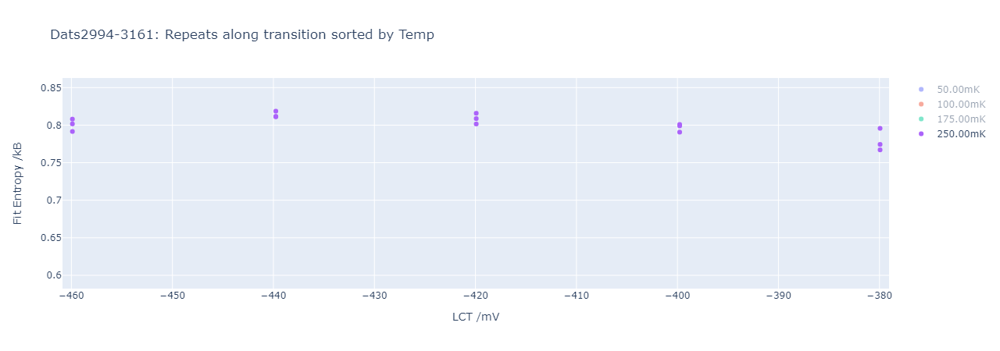

In [17]:
fig = go.Figure()

which_sort = 'temp'
which_x = 'lct'
which_y = 'fit_ds'

if which_sort.lower() == 'temp':
    name = 'Temp'
    units = 'mK'
    array = (50, 100, 175, 250)
    get_val = lambda dat: dat.Logs.temps.mc*1000
    tol = 10
elif which_sort.lower() == 'field':
    name = 'Field'
    units = 'mT'
#     array = np.linspace(-188, -212, 25)
    array = np.linspace(-55, -45, 21)
#     array = np.linspace(-25, -15, 21)
    get_val = lambda dat: dat.Logs.magy.field
    tol = 0.2
elif which_sort.lower() == 'lct':
    name = 'LCT'
    units = 'mV'
    array = np.linspace(-460, -380, 5)
    get_val = lambda dat: dat.Logs.fds['LCT']
    tol = 5
elif which_sort.lower() == 'hqpc':
    name = 'HQPC bias'
    units = 'mV'
    array = np.linspace(117.5, 122.5, 11)
    get_val = lambda dat: dat.AWG.AWs[0][0][1]
    tol = 0.2
else:
    raise ValueError

if which_x.lower() == 'lct':
    get_x = lambda dat: dat.Logs.fds['LCT']
    x_title = 'LCT /mV'
elif which_x.lower() == 'field':
    get_x = lambda dat: dat.Logs.magy.field
    x_title = 'Field /mT'
elif which_x.lower() == 'temp':
    get_x = lambda dat: dat.Logs.temps.mc*1000
    x_title = 'MC Temp /mK'
elif which_x.lower() == 'hqpc':
    get_x = lambda dat: dat.AWG.AWs[0][0][1]
    x_title = 'HQPC bias /mV'
else:
    raise ValueError
    
if which_y.lower() == 'dt':
    get_y = lambda values: values.dTs
    y_title = 'dT /mV'
elif which_y.lower() == 'fit_ds':
    get_y = lambda values: values.dSs
    y_title = 'Fit Entropy /kB'
elif which_y.lower() == 'int_ds':
    get_y = lambda values: values.int_dSs
    y_title = 'Integrated Entropy /kB'
else:
    raise ValueError

for val in array:
    ds = [dat for dat in dats if np.isclose(get_val(dat), val, atol=tol)]
    dps = [pair for pair in dat_pairs if np.isclose(get_val(pair[0]), val, atol=tol)]
    values = EA.EA_values.from_dats(ds)
    x = [get_x(p[0]) for p in dps]
    y = get_y(values)
    datnums = [p[0].datnum for p in dps]
    base_hover_template = 'Datnum: %{customdata}<br>'
    hover_template = base_hover_template+x_title+': %{x:.2f}<br>'+y_title+': %{y:.2f}'
    fig.add_trace(go.Scatter(x=x, y=y, name=f'{val:.2f}{units}', mode='markers', customdata=datnums,  hovertemplate = hover_template))
#     fig.add_trace(go.Scatter(x=x, y=values.dTs, mode='markers'))
fig.update_layout(title=f'Dats{dats[0].datnum}-{dats[-1].datnum}: Repeats along transition sorted by {name}', xaxis_title=x_title, yaxis_title=y_title)
fig.show()
    


In [18]:
save_graph=True
if save_graph:
    fig.write_html(export_path+f'Dats{dats[0].datnum}-{dats[-1].datnum} -- Entropy Repeats along transition various {name}.html')

In [12]:
print(list(np.linspace(-21, -19, 21)))

[-21.0, -20.9, -20.8, -20.7, -20.6, -20.5, -20.4, -20.3, -20.2, -20.1, -20.0, -19.9, -19.8, -19.7, -19.6, -19.5, -19.4, -19.3, -19.2, -19.1, -19.0]


In [279]:
from src.DatObject.Attributes import SquareEntropy as SE, Transition as T, Entropy as E, DatAttribute as DA


allowed_amps = (0.8, 1.2)
default_amp = 1.05
allowed_dTs = (1, 30)
default_dT = 2.7
sub_line = False

xs, trans_datas, entropy_datas, integrated_datas, ids, trans_titles, entropy_titles, integrated_titles = list(), list(), list(), list(), list(), list(), list(), list()

for pair in progressbar(dat_pairs):
    dat = pair[0]
    if dat.Logs.fds["LCT"] > -350:
        centers = [0]*len(dat.Data.y_array)
    else:
        centers = None
    x, averaged_data = EA.merge_dat_parts(pair, centers=centers)
    entropy_data = SE.entropy_signal(averaged_data)
    
    # Calculate Integrated Entropy
    line = lm.models.LinearModel()
    dat_tcs, dat_amps, dat_centers = list(), list(), list()
    for data in averaged_data[0::2]:
        fit = T.transition_fits(x, data, func=T.i_sense)[0]
        dat_tcs.append(fit.best_values['theta'])
        dat_amps.append(fit.best_values['amp'])
        dat_centers.append(fit.best_values['mid'])
    dat_ths = list()
    for data in averaged_data[1::2]:
        fit = T.transition_fits(x, data, func=T.i_sense)[0]
        dat_ths.append(fit.best_values['theta'])
    tc = np.nanmean(dat_tcs)
    th = np.nanmean(dat_ths)
    dT = th-tc
    amp = np.average(dat_amps)
    mid = np.average(dat_centers)
    mid = mid if (-1000 < mid < 1000) else 0
    
    if not (allowed_amps[0] < amp < allowed_amps[1]):
        amp = default_amp
    if not (allowed_dTs[0] < dT < allowed_dTs[1]):
        dT = default_dT
    
    dx = np.mean(np.diff(x))
    sf = SE.scaling(dt=dT, amplitude=amp, dx=dx)
    int_info = SE.IntegratedInfo(dT=dT, amp=amp, dx=dx)
    integrated_data = SE.integrate_entropy(entropy_data, int_info.sf)
    
    if sub_line is True:
        indexs = CU.get_data_index(x, [mid-4000, mid-1000])
        line_fit = line.fit(integrated_data[indexs[0]:indexs[1]], x=x[indexs[0]:indexs[1]], nan_policy='omit')
        integrated_data = integrated_data-line_fit.eval(x=x)
        
    indexs = CU.get_data_index(x, [mid+300, mid+1000])
    int_dS = np.mean(integrated_data[indexs[0]:indexs[1]]) 

    # Calculate Nik Fit
    e_pars = E.get_param_estimates(x, entropy_data)[0]
    e_pars = CU.edit_params(e_pars, 'const', 0, False)
    efit = E.entropy_fits(x, entropy_data, params=e_pars)[0]
    efit_info = DA.FitInfo()
    efit_info.init_from_fit(efit)
    
    
    ids.append(f'{dat.datnum}')
    xs.append(x)
    trans_datas.append(averaged_data)
    entropy_datas.append([efit_info.eval_fit(x=x), entropy_data])
    integrated_datas.append(integrated_data)
    
    channel_ratio = round(dat.AWG.AWs[1][0][1]/dat.AWG.AWs[0][0][1]/-0.028, 2)
    dsp = dat.SquareEntropy.Processed
    scan_freq = dat.Logs.Fastdac.measure_freq/dat.AWG.info.wave_len
    fit_text = f'SF={sf:.2f}, Amp={amp:.3f}nA, T_cold={tc:.3f}mV, T_hot={th:.3f}mV, dT={dT:.3f}mV, fit_dS={efit_info.best_values.dS:.3f}kB'
    scan_text = f'LCT={dat.Logs.fds["LCT"]}, HQPCbiases=({dat.AWG.AWs[0][0][1]:.0f}mV, {dat.AWG.AWs[0][0][3]:.0f}mV), Channel Biases=({dat.AWG.AWs[1][0][1]:.1f}mV, {dat.AWG.AWs[1][0][3]:.1f}mV), Perp Field={dat.Logs.magy.field:.1f}mT'
    array_text = f'Channel Bias Ratio = {channel_ratio}, Square Wave Frequency = {scan_freq:.1f}Hz, Sweeprate (LP*200) = {dat.Logs.sweeprate:.1f}mV/s'
    text_info = f'{array_text}<br>{scan_text}<br>{fit_text}'
    trans_titles.append(f'Dat{dat.datnum}: Averaged CS data<br>{text_info}')
    entropy_titles.append(f'Dat{dat.datnum}: Entropy data with fit<br>{text_info}')
    integrated_titles.append(f'Dat{dat.datnum}: Integrated Entropy data<br>{text_info}')
    
    
fig1 = PlU.get_figure(datas=trans_datas, xs=xs, ids=ids, titles=trans_titles, labels=['v0_0', 'vp', 'v0_1', 'vm'], xlabel=f'{dat.Logs.x_label}', ylabel='Current /nA', plot_kwargs={'mode':'lines+markers'})
fig2 = PlU.get_figure(datas=entropy_datas, xs=xs, ids=ids, titles=entropy_titles, labels=['fit', 'data'], xlabel=f'{dat.Logs.x_label}', ylabel='Current /nA', plot_kwargs={'mode':'lines+markers'})
fig3 = PlU.get_figure(datas=integrated_datas, xs=xs, ids=ids, titles=integrated_titles, xlabel=f'{dat.Logs.x_label}', ylabel='Entropy /kB', plot_kwargs={'mode':'lines+markers'})

    


N/A% (0 of 20) |                         | Elapsed Time: 0:00:00 ETA:  --:--:--WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
  5% (1 of 20) |#                        | Elapsed Time: 0:00:00 ETA:   0:00:05WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
 10% (2 of 20) |##                       | Elapsed Time: 0:00:00 ETA:   0:00:04WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
 15% (3 of 20) |###                      | Elapsed Time: 0:00:00 ETA:   0:00:04WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
 20% (4 of 20) |#####                    | Elapsed Time: 0:00:00 ETA:   0:00:03WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
 85% (17 of 20) |####################    | Elapsed Time: 0:00:04 ETA:   0:00:00WARNING:src.DatObject.Attributes.Transition:LinAlgError encountered, retrying
 90% (18 of 20) |#####################   | Elapsed Time: 0

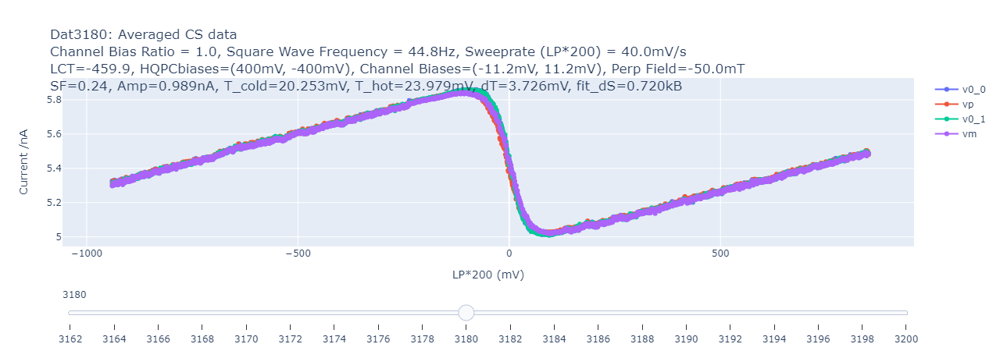

In [281]:
fig1.show()

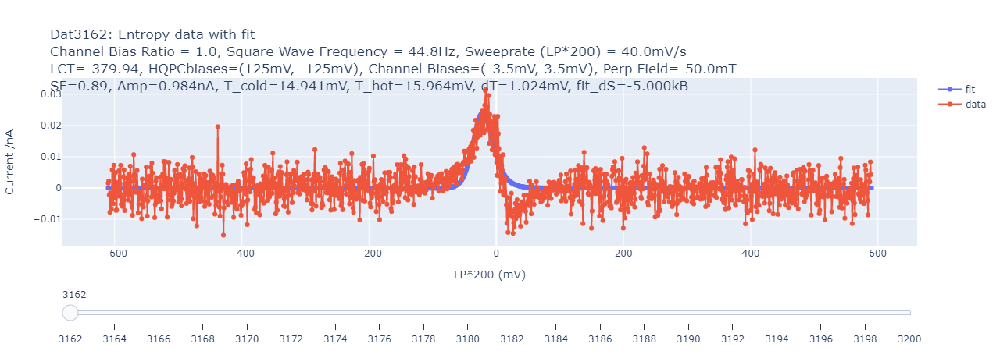

In [282]:
fig2.show()